## **Data Exploration and Preparation**

This section is dedicated to 

In [ ]:
from matplotlib import pyplot as plt
from torch.utils.data import random_split

import albumentations as A
import matplotlib.patches as patches

from modules.data import FootballDataset, FootballDatasetConfig

In [2]:
ROOT_DATASET_PATH = "datasets/Soccerball"

## **1. Data Exploration**

### **1.1. Dataset Size and Distribution**

##### **Purpose:**  

To determine how many images are in the dataset and how they are distributed across the training, validation, and test sets. This will help determine the appropriate modeling strategy.
- A **small dataset** typically requires a simpler model and extensive data augmentation to generalize.
- A **large dataset** enables training more complex architectures with reduced overfitting concerns.
- Additionally, verifying the train/val/test split ensures adherence to standard conventions and prevents data leakage.

##### **Method:**
- Calculate the total number of images in the dataset.
- Determine the distribution of images across the training, validation, and test sets.

In [3]:
train_data_config = FootballDatasetConfig(
    root_data_path=ROOT_DATASET_PATH,
    dataset_category="train",
    normalize_image=False,
    normalize_bbox=False,
)
train_dataset = FootballDataset(config = train_data_config)

valid_data_config = FootballDatasetConfig(
    root_data_path=ROOT_DATASET_PATH,
    dataset_category="valid",
    normalize_image=False,
    normalize_bbox=False,
)
valid_dataset = FootballDataset(config = valid_data_config)


test_data_config = FootballDatasetConfig(
    root_data_path=ROOT_DATASET_PATH,
    dataset_category="test",
    normalize_image=False,
    normalize_bbox=False,
)
test_dataset = FootballDataset(config = test_data_config)

/Users/tobiojekanmi/Documents/Projects/python/ml-project/football-detection/.venv/lib/python3.13/site-packages/albumentations/core/composition.py:359: UserWarning: Got processor for bboxes, but no transform to process it.
  self._set_keys()
/Users/tobiojekanmi/Documents/Projects/python/ml-project/football-detection/.venv/lib/python3.13/site-packages/albumentations/core/composition.py:359: UserWarning: Got processor for bboxes, but no transform to process it.
  self._set_keys()
/Users/tobiojekanmi/Documents/Projects/python/ml-project/football-detection/.venv/lib/python3.13/site-packages/albumentations/core/composition.py:359: UserWarning: Got processor for bboxes, but no transform to process it.
  self._set_keys()


In [4]:
num_train_images = len(train_dataset)
num_val_images = len(valid_dataset)
num_test_images = len(test_dataset)
total_images = num_train_images + num_val_images + num_test_images

print("Total number of images:", total_images)
print(f"Number of training images: {num_train_images} ({num_train_images / total_images:.2%})")
print(f"Number of validation images: {num_val_images} ({num_val_images / total_images:.2%})")
print(f"Number of test images: {num_test_images} ({num_test_images / total_images:.2%})")


Total number of images: 330
Number of training images: 230 (69.70%)
Number of validation images: 65 (19.70%)
Number of test images: 35 (10.61%)


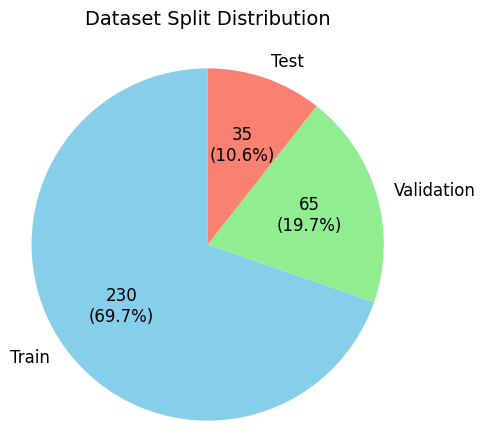

In [5]:
import matplotlib.pyplot as plt

splits = ['Train', 'Validation', 'Test']
counts = [num_train_images, num_val_images, num_test_images]

# Custom autopct to show both number and percentage
def autopct_format(pct, all_vals):
    absolute = int(round(pct/100.*sum(all_vals)))
    return f"{absolute}\n({pct:.1f}%)"

plt.figure(figsize=(5, 5))
plt.pie(
    counts, 
    labels=splits, 
    autopct=lambda pct: autopct_format(pct, counts),
    startangle=90,
    colors=['skyblue', 'lightgreen', 'salmon'],
    textprops={'fontsize': 12}  # Better text readability
)
plt.title('Dataset Split Distribution', fontsize=14, pad=20)
plt.axis('equal')

# Use plt.savefig() instead of plt.imsave() for figures
plt.savefig("./assets/data-distribution.png", dpi=300, bbox_inches='tight')
plt.show()

##### **Findings:**  
- The dataset contains a total of 330 images.
- The training set contains 230 images (69.7%), the validation set contains 65 images (19.7%), and the test set contains 35 images (10.6%).
- The dataset is balanced across the three classes.

##### **Conclusion:**  
The dataset was properly split across the three categories. However, the small size of the dataset may limit the model's ability to learn or generalize to new, unseen data. Therefore, it is recommended to train a small model and use data augmentation techniques to increase the size and diversity of the dataset, as this could improve the model's performance.


<br>
<br>
<br>
<br>

### **1.2 Dataset Quality Analysis**
##### **Purpose:**  

To assess the accuracy of bounding box annotations and the diversity of the image dataset. A high-quality dataset requires both precise labels and sufficient variability to ensure robust model generalization under real-world conditions.

##### **Method:**

- Randomly sample images from the dataset.
- Perform a visual inspection of the samples and confirm the tightness of their bounding boxes.
- Audit the dataset for a wide range of visual and environmental factors (e.g., lighting, background variation, weather, object occlusion, weather e.t.c.).

In [6]:
# Sample 10 data points
sample_size = 10
train_dataset_samples, _ = random_split(train_dataset, [sample_size, len(train_dataset) - sample_size])
valid_dataset_samples, _ = random_split(valid_dataset, [sample_size, len(valid_dataset) - sample_size])
test_dataset_samples, _ = random_split(test_dataset, [sample_size, len(test_dataset) - sample_size])

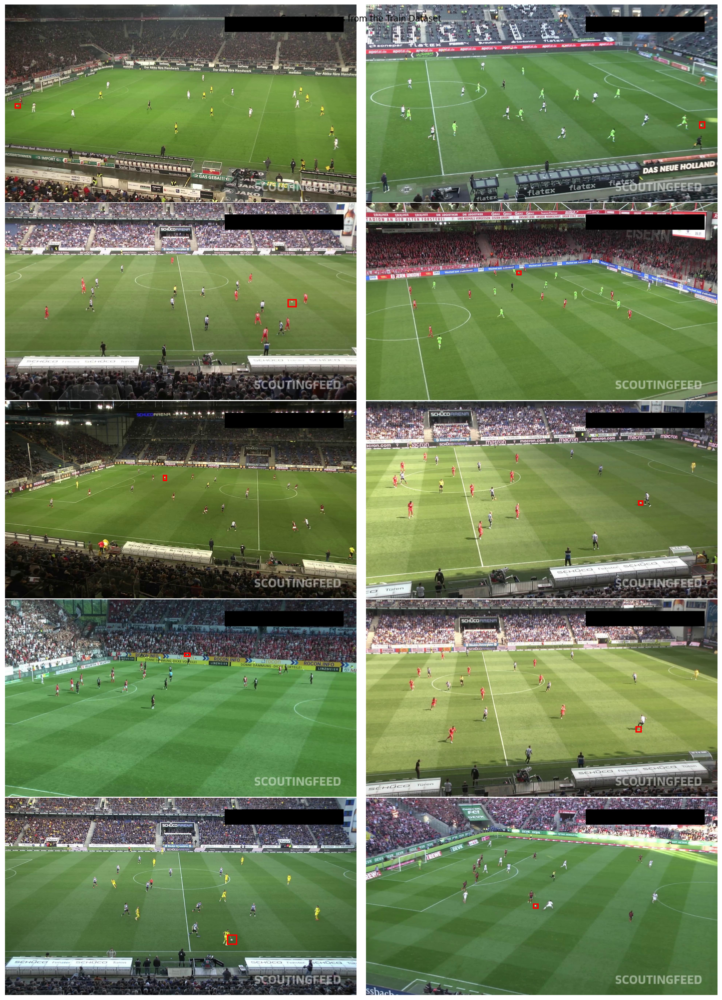

In [7]:
fig, axes = plt.subplots(5, 2, figsize=(15, 20))
plt.suptitle("Sample Images from the Train Dataset")

for idx, (_, image, bbox) in enumerate(train_dataset_samples):
    row = idx // 2
    col = idx % 2
    image = image.permute(1, 2, 0).numpy()
    axes[row, col].imshow(image)
    axes[row, col].axis('off')
    
    # GT - green
    axes[row, col].add_patch(
        plt.Rectangle(  # type: ignore
            (bbox[0], bbox[1]),
            bbox[2] - bbox[0],
            bbox[3] - bbox[1],
            fill=False,
            color="red",
            linewidth=2,
        )
    )

    if idx == 9:
        break

plt.tight_layout(pad=0.1) 
plt.show()

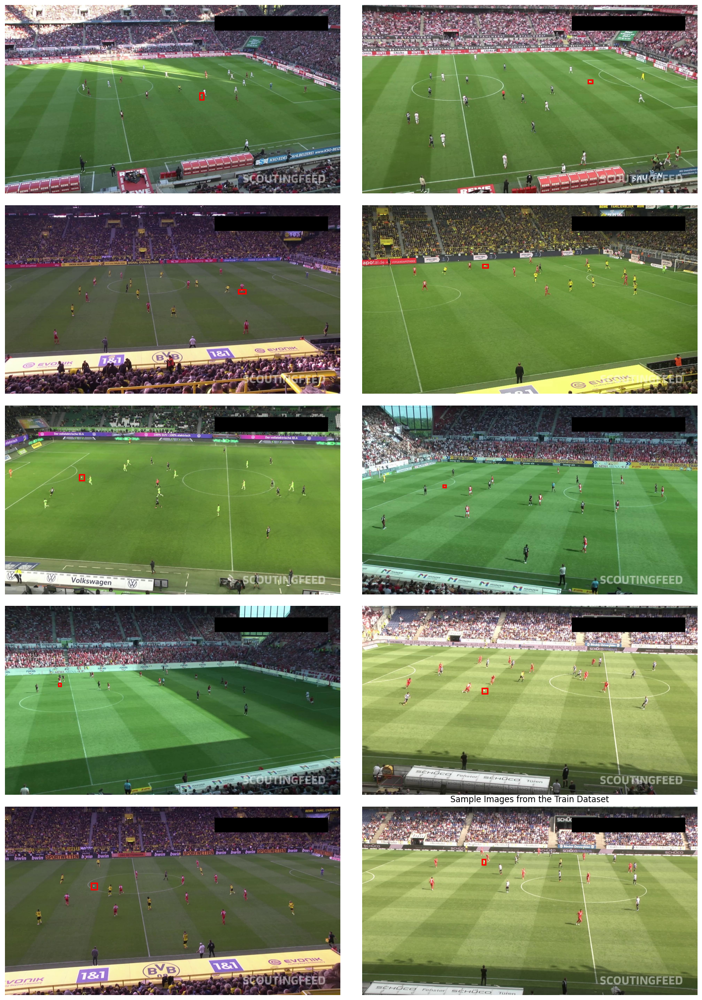

In [8]:
fig, axes = plt.subplots(5, 2, figsize=(15, 20))
plt.title("Sample Images from the Train Dataset")

for idx, (_, image, bbox) in enumerate(valid_dataset_samples):
    row = idx // 2
    col = idx % 2
    image = image.permute(1, 2, 0).numpy()
    axes[row, col].imshow(image)
    axes[row, col].axis('off')
    
    # GT - green
    axes[row, col].add_patch(
        plt.Rectangle(  # type: ignore
            (bbox[0], bbox[1]),
            bbox[2] - bbox[0],
            bbox[3] - bbox[1],
            fill=False,
            color="red",
            linewidth=2,
        )
    )

    if idx == 9:
        break

plt.tight_layout(pad=0.1) 
plt.show()

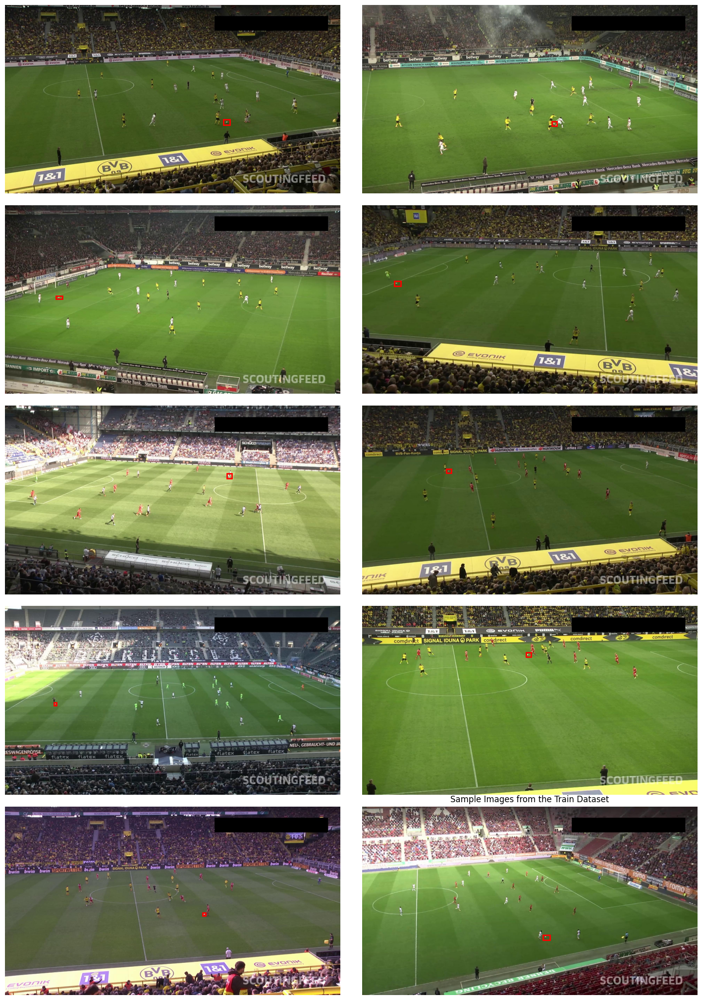

In [9]:
fig, axes = plt.subplots(5, 2, figsize=(15, 20))
plt.title("Sample Images from the Train Dataset")

for idx, (_, image, bbox) in enumerate(test_dataset_samples):
    row = idx // 2
    col = idx % 2
    image = image.permute(1, 2, 0).numpy()
    axes[row, col].imshow(image)
    axes[row, col].axis('off')
    
    # GT - green
    axes[row, col].add_patch(
        plt.Rectangle(  # type: ignore
            (bbox[0], bbox[1]),
            bbox[2] - bbox[0],
            bbox[3] - bbox[1],
            fill=False,
            color="red",
            linewidth=2,
        )
    )

    if idx == 9:
        break

plt.tight_layout(pad=0.1) 
plt.show()

##### **Findings:**  

- The annotations appears to be accurate and consistent, as there are a no loose boxes, and any boxes shifted away from the object.

- The dataset also exhibits a fair amount of diversity, as the images display variability in lighting, camera viewpoints, and the type of football used. The dataset, however, seems to lack variable environmental conditions, such as cloudy or rainy weather; hence, any model developed from it might not perform well under such conditions. The objects in the dataset also appear to be of a consistent scale.

- The target object (football) is very small and constitute only a small percentage of the entire image. This would likely make training difficult as we cannot reduce the size of the given image or zoom out the image without worrying that the entire ball could disappear.

- The training, validation, and testing data appear to have been selected randomly from a single pool. This approach helps to ensure that the model is trained and evaluated on the same data distribution.


##### **Conclusion:**

Based on the findings, it is recommended to implement a comprehensive data augmentation strategy to compensate for the dataset's lack of scale diversity and improve model generalization. We should prioritize geometric transformations such as scaling (only zooming in) and flipping, while photometric augmentations should also be tested to evaluate their potential for yielding additional performance gains.


<br><br><br><br>

## **2. Data Augmentation**

##### **Purpose:**
To evaluate how various data augmentation strategies affect dataset quality, with a specific focus on the visibility of the football after transformation.

##### **Method:**
- Apply a range of geometric and photometric augmentation techniques to sample images from the training set.
- Assess the impact of each technique on football visibility to determine the optimal augmentation strategy.
- Tune the augmentation parameters to quantify the risk associated with each technique.

In [10]:
def apply_and_visualize_transform(transform, items):
    """
    Apply transformation to items and visualize before/after results.
    
    Args:
        transform: Albumentations transform object
        items: List of tuples containing (image, bboxes) pairs
    """
    for item in items:
        # Apply transformation
        transformed = transform(
            image=item[0],
            bboxes=item[1], 
            category_ids=[0] * len(item[1]),  # Generate category_ids based on bbox count
        )
        
        # Extract transformed results
        transformed_image = transformed['image']
        transformed_bboxes = transformed['bboxes']
        
        # Convert to list if it's a tensor/array
        if hasattr(transformed_bboxes, 'tolist'):
            transformed_bboxes = transformed_bboxes.tolist()
        
        # Create visualization
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
        
        # Original image with bboxes
        ax1.imshow(item[0])
        ax1.set_title('Original')
        for bbox in item[1]:
            x_min, y_min, x_max, y_max = bbox
            rect = patches.Rectangle((x_min, y_min), x_max-x_min, y_max-y_min, 
                                    linewidth=2, edgecolor='r', facecolor='none')
            ax1.add_patch(rect)
        ax1.axis('off')

        # Transformed image with bboxes
        ax2.imshow(transformed_image)
        ax2.set_title('Transformed')
        for bbox in transformed_bboxes:
            x_min, y_min, x_max, y_max = bbox
            rect = patches.Rectangle((x_min, y_min), x_max-x_min, y_max-y_min, 
                                    linewidth=2, edgecolor='r', facecolor='none')
            ax2.add_patch(rect)
        ax2.axis('off')
        
        plt.tight_layout()
        plt.show()

In [11]:
bbox_params=A.BboxParams(format='pascal_voc', label_fields=['category_ids'])

image_1 = train_dataset[14][1].permute(1, 2, 0).numpy()
bbox_1 = [train_dataset[14][2].tolist()]

image_2 = train_dataset[22][1].permute(1, 2, 0).numpy()
bbox_2 = [train_dataset[22][2].tolist()]

data = [[image_1, bbox_1], [image_2, bbox_2]]


### **2.1 Random Horizontal Flip**

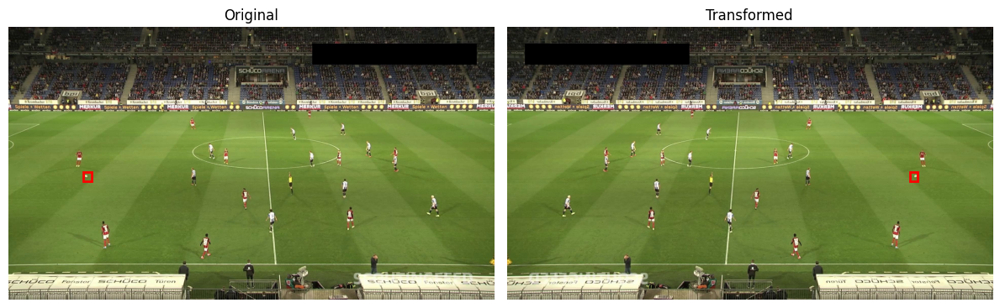

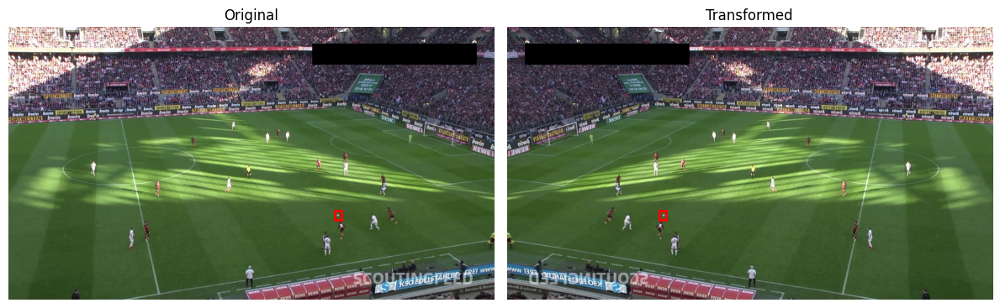

In [12]:
transform = A.Compose([A.HorizontalFlip(p=1.0)], 
    bbox_params=bbox_params
)

apply_and_visualize_transform(transform, data )


### **2.2 Random Vertical Flip**

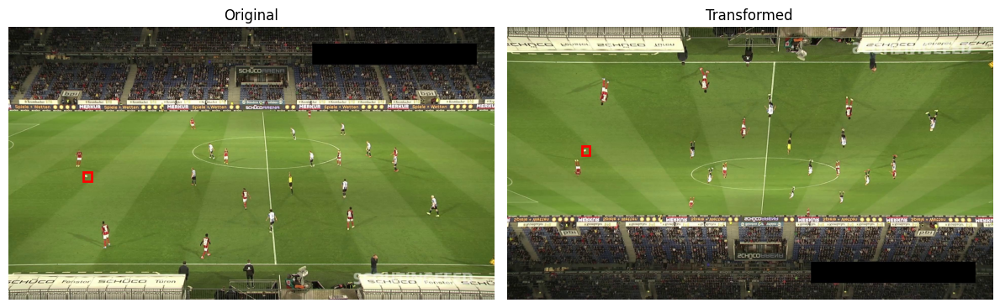

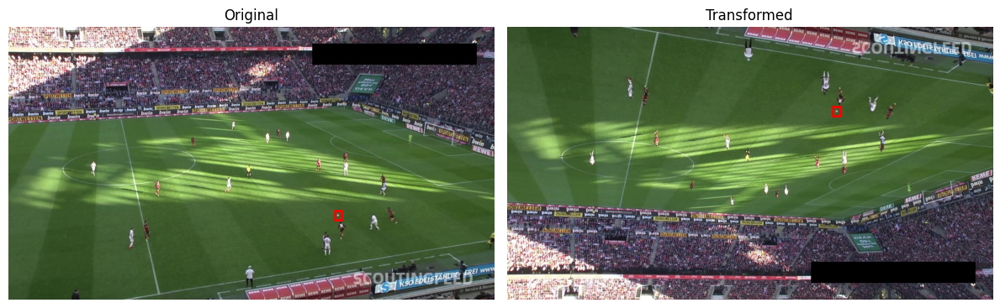

In [13]:
transform = A.Compose([A.VerticalFlip(p=1.0)], 
    bbox_params=bbox_params
)
apply_and_visualize_transform(transform, data)

### **2.3 Random Rotation**

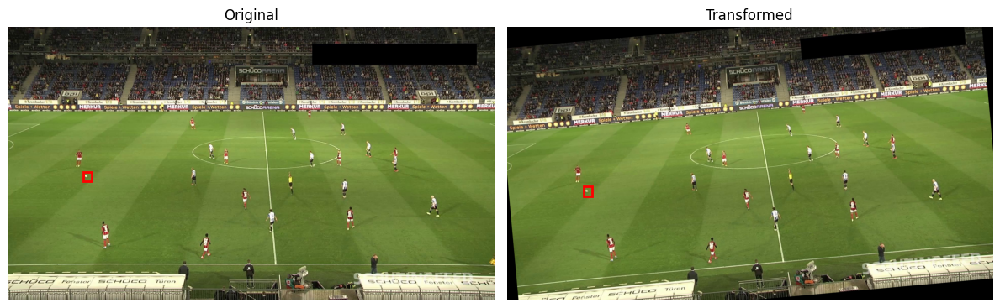

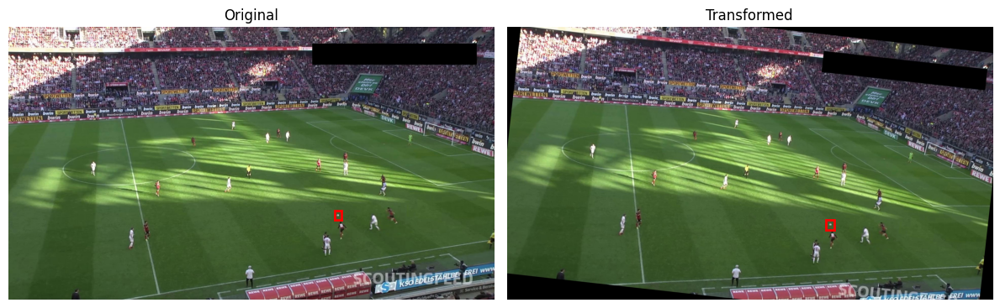

In [14]:
transform = A.Compose([A.Rotate(limit=10, p=1.0)], 
    bbox_params=bbox_params
)
apply_and_visualize_transform(transform, data)

### **2.4 Random Zoom (Zoom In)**

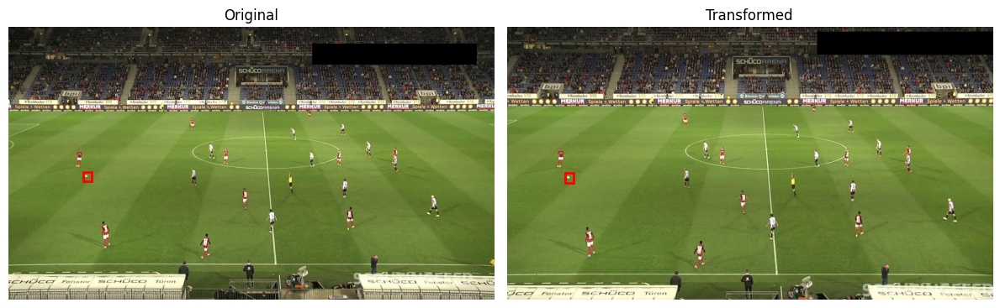

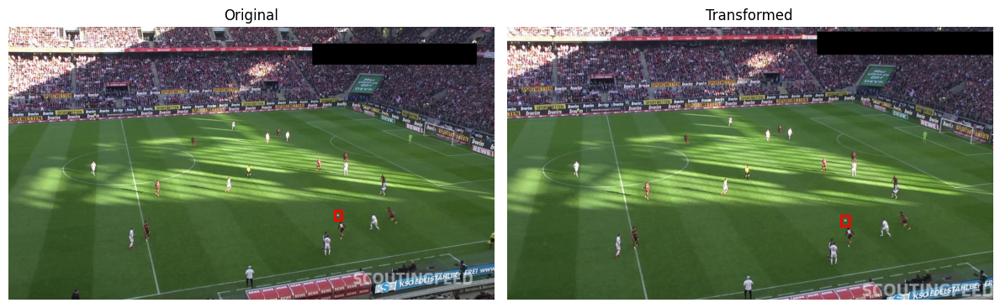

In [15]:
transform = A.Compose([A.Affine(scale=1.1, p=1.0)], 
    bbox_params=bbox_params
)
apply_and_visualize_transform(transform, data)

### **2.5 Random Zoom (Zoom Out)**

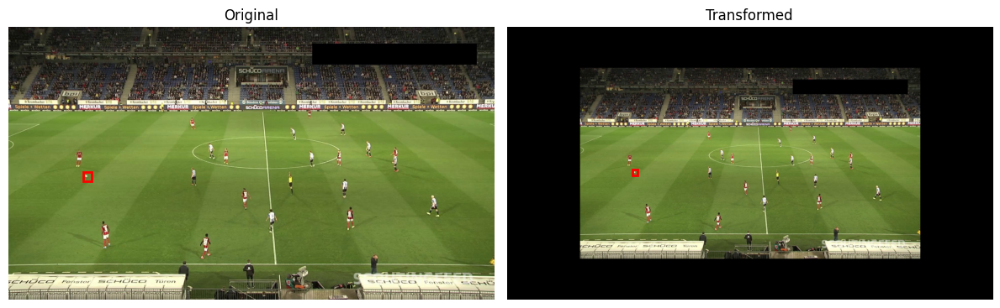

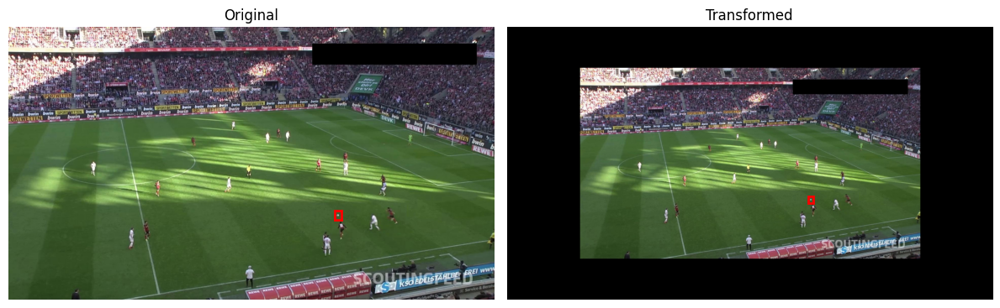

In [16]:
transform = A.Compose([A.Affine(scale=0.7, p=1.0)], 
    bbox_params=bbox_params
)
apply_and_visualize_transform(transform, data)

### **2.6 Random Translation**

In [ ]:
transform = A.Compose([A.Affine(
    translate_percent=0.2,
    p=1.0
)], 
    bbox_params=bbox_params
)
apply_and_visualize_transform(transform, data)

### **2.7 Perspective**

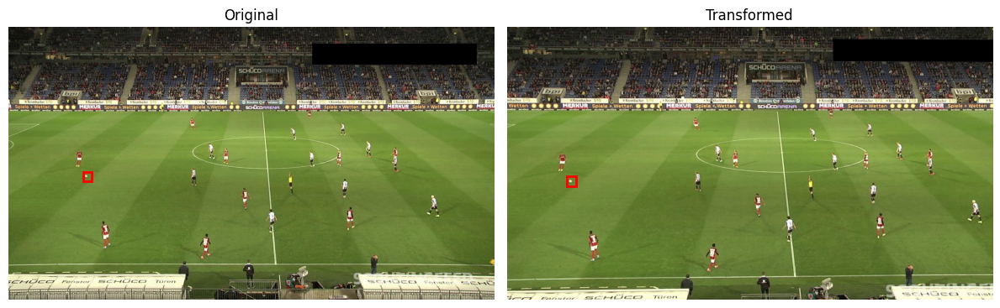

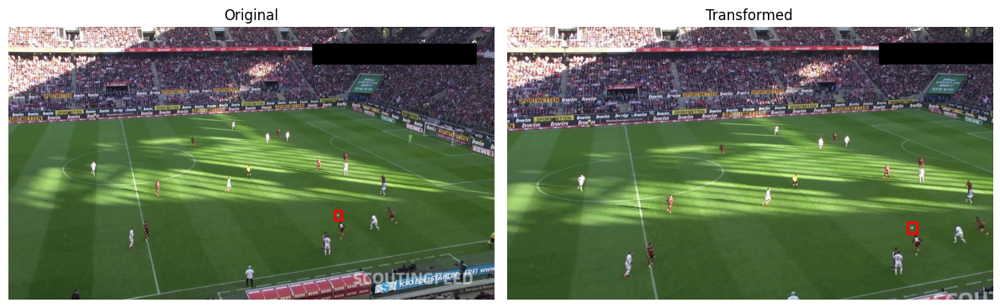

In [17]:
transform = A.Compose([A.Perspective(
    scale=0.2,
    p=1.0
)], 
    bbox_params=bbox_params
)
apply_and_visualize_transform(transform, data)

### **2.8 Random Crop**

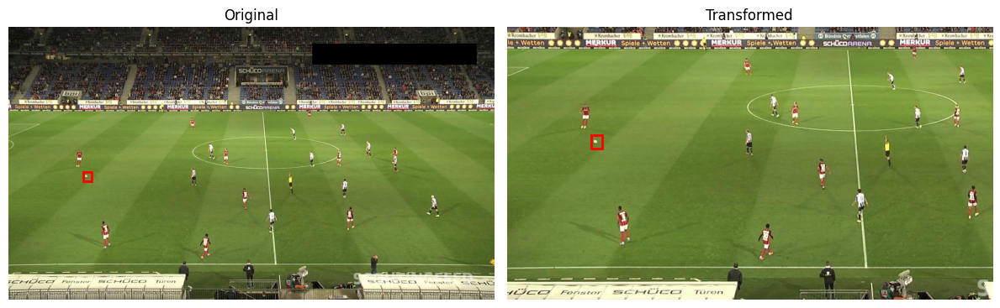

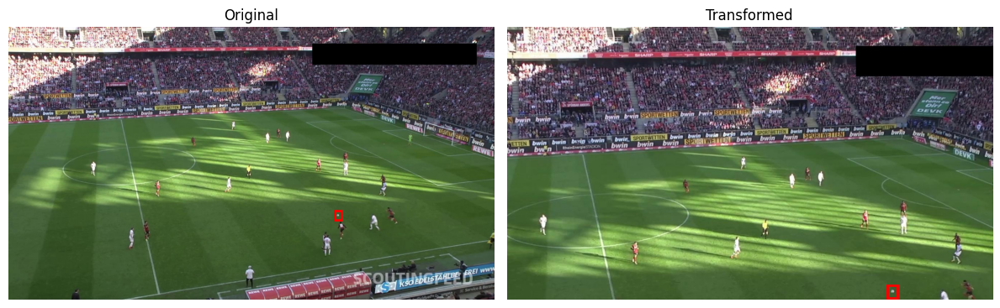

In [18]:
transform = A.Compose([A.RandomCrop(
    width=int(1920 * 0.7),
    height=int(1080 * 0.7),
    p=1.0
)], 
    bbox_params=bbox_params
)
apply_and_visualize_transform(transform, data)